In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import anndata
import re
import h5py
import scipy.sparse as scs
import concurrent.futures
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.sparse import csc_matrix
from concurrent.futures import ThreadPoolExecutor, as_completed
import umap
import random
import multiprocessing
random.seed(123)
from joblib import Parallel, delayed
import copy
import os
from tqdm import tqdm
import math
import scanpy.external as sce
from concurrent.futures import ProcessPoolExecutor
from adjustText import adjust_text
from PIL import Image, ImageDraw, ImageFont
import gc
import multiprocessing

In [2]:
def gen_mpl_labels(
    adata, groupby, exclude=(), ax=None, adjust_kwargs=None, text_kwargs=None
):
    if adjust_kwargs is None:
        adjust_kwargs = {"text_from_points": False}
    if text_kwargs is None:
        text_kwargs = {}

    medians = {}

    for g, g_idx in adata.obs.groupby(groupby).groups.items():
        if g in exclude:
            continue
        medians[g] = np.median(adata[g_idx].obsm["X_umap"], axis=0)

    if ax is None:
        texts = [
            plt.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()]
    else:
        texts = [ax.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()]

    adjust_text(texts, **adjust_kwargs)

In [3]:
def run_leiden(adata, resolution, key_added):
    
    adata_copy = copy.deepcopy(adata)
    adata_clustering = sc.tl.leiden(adata_copy, resolution=resolution, key_added=key_added,n_iterations=3, copy=True)
    return adata_clustering.obs

def run_leiden_parallel(adata, tasks):
    with ProcessPoolExecutor(max_workers=2) as executor:
        futures = [executor.submit(run_leiden, copy.deepcopy(adata), resolution, key_added) for resolution, key_added in tasks]
        
        results = [future.result() for future in futures]

    for result, (_, key_added) in zip(results, tasks):
        adata.obs[key_added] = result[key_added]

    return adata

In [4]:
files = os.listdir("h5_cleaned_by_celltype/")
pattern = re.compile(r'T cell|MAIT|aa|gdT|Treg')

files = [s for s in files if pattern.search(s)]
print(len(files))
files


35


['KLRF1- effector Vd1 gdT.h5ad',
 'GZMK+ Vd2 gdT.h5ad',
 'CD8aa.h5ad',
 'GZMK- CD27+ EM CD8 T cell.h5ad',
 'KLRF1+ GZMB+ CD27- EM CD8 T cell.h5ad',
 'Memory CD8 Treg.h5ad',
 'CD4 MAIT.h5ad',
 'SOX4+ Vd1 gdT.h5ad',
 'KLRB1+ memory CD8 Treg.h5ad',
 'GZMB+ Vd2 gdT.h5ad',
 'GZMB- CD27+ EM CD4 T cell.h5ad',
 'GZMK+ memory CD4 Treg.h5ad',
 'KLRB1+ memory CD4 Treg.h5ad',
 'CM CD4 T cell.h5ad',
 'GZMK+ CD27+ EM CD8 T cell.h5ad',
 'Core naive CD8 T cell.h5ad',
 'SOX4+ naive CD4 T cell.h5ad',
 'KLRF1+ effector Vd1 gdT.h5ad',
 'ISG+ naive CD8 T cell.h5ad',
 'CD8 MAIT.h5ad',
 'CM CD8 T cell.h5ad',
 'ISG+ naive CD4 T cell.h5ad',
 'Proliferating T cell.h5ad',
 'SOX4+ naive CD8 T cell.h5ad',
 'Core naive CD4 T cell.h5ad',
 'ISG+ memory CD8 T cell.h5ad',
 'Naive Vd1 gdT.h5ad',
 'KLRF1- GZMB+ CD27- EM CD8 T cell.h5ad',
 'Naive CD4 Treg.h5ad',
 'KLRF1- GZMB+ CD27- memory CD4 T cell.h5ad',
 'GZMB- CD27- EM CD4 T cell.h5ad',
 'ISG+ memory CD4 T cell.h5ad',
 'ISG+ MAIT.h5ad',
 'Memory CD4 Treg.h5ad',
 'DN 

In [5]:
adata_list=[]
for i in files:
    adata_sinlge=sc.read_h5ad("h5_cleaned_by_celltype/"+i)
    adata_list.append(adata_sinlge)

In [6]:
adata=anndata.concat(adata_list)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [7]:
del adata_list
gc.collect()

31051

In [9]:
%%time

sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata)
adata = adata[:, adata.var_names[adata.var['highly_variable']]]
sc.pp.scale(adata)
sc.tl.pca(adata, svd_solver='arpack')

/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:215: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:842: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs

CPU times: user 1h 13min 44s, sys: 9min 44s, total: 1h 23min 28s
Wall time: 8min 3s


In [10]:
%%time
sce.pp.harmony_integrate(adata, 'pool_id',max_iter_harmony = 10)

2024-05-06 03:24:11,146 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-06 03:33:41,789 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-06 03:33:49,801 - harmonypy - INFO - Iteration 1 of 10
2024-05-06 03:48:29,758 - harmonypy - INFO - Iteration 2 of 10
2024-05-06 04:03:39,307 - harmonypy - INFO - Iteration 3 of 10
2024-05-06 04:17:59,646 - harmonypy - INFO - Iteration 4 of 10
2024-05-06 04:32:12,573 - harmonypy - INFO - Converged after 4 iterations


CPU times: user 10h 36min 12s, sys: 11h 21min 8s, total: 21h 57min 21s
Wall time: 1h 8min 3s


In [ ]:
%%time
sc.pp.neighbors(adata, n_neighbors=50,use_rep='X_pca_harmony', n_pcs=30)
sc.tl.umap(adata,min_dist=0.45)


In [ ]:
adata=adata.raw.to_adata()
adata.write_h5ad('Tcells_leiden.h5ad')

In [14]:
adata

AnnData object with n_obs × n_vars = 2310988 × 18082
    obs: 'barcodes', 'batch_id', 'cell_name', 'cell_uuid', 'celltype.l1', 'celltype.l1.score', 'celltype.l2', 'celltype.l2.score', 'celltype.l3', 'celltype.l3.score', 'chip_id', 'n_genes', 'n_mito_umis', 'n_reads', 'n_umis', 'original_barcodes', 'pool_id', 'sampleID', 'well_id', 'celltypist_l1', 'celltypist_l2', 'celltypist_l3', 'predicted_doublet', 'doublet_score', 'age_enrollment', 'biological_sex', 'subject_guid', 'race', 'cmv_status', 'cmv_index', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden_2', 'leiden'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    obsp: 'distances', 'connectivities'

In [4]:
adata=sc.read_h5ad('Tcells_leiden.h5ad')

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [5]:
%%time
tasks = [(1, "leiden_resolution_1")]
adata = run_leiden_parallel(adata, tasks)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
Process ForkProcess-2:
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/multiprocessing/process.py", line 314, in _bootstrap
    self.run()
  File "/opt/conda/lib/python3.10/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
  File "/opt/conda/lib/python3.10/concurrent/futures/process.py", line 240, in _process_worker
    call_item = call_queue.get(block=True)
  File "/opt/conda/lib/python3.10/multiprocessing/queues.py", line 103, in get
    res = self._recv_bytes()
  File "/opt/conda/lib/python3.10/multiprocessing/connection.py", line 216, in recv_bytes
    buf = self._recv_bytes(maxlength)
  File "/opt/conda/lib/python3.10/multiprocessing/connection.py", line 414, in _recv_bytes
    buf = self._recv(4)
  File "/opt/conda

KeyboardInterrupt: 

In [ ]:
adata

In [7]:
adata.write_h5ad('Tcells_leiden.h5ad')

In [6]:
adata.obs.index=adata.obs['barcodes']

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/tmp/ipykernel_75369/3047688266.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observe

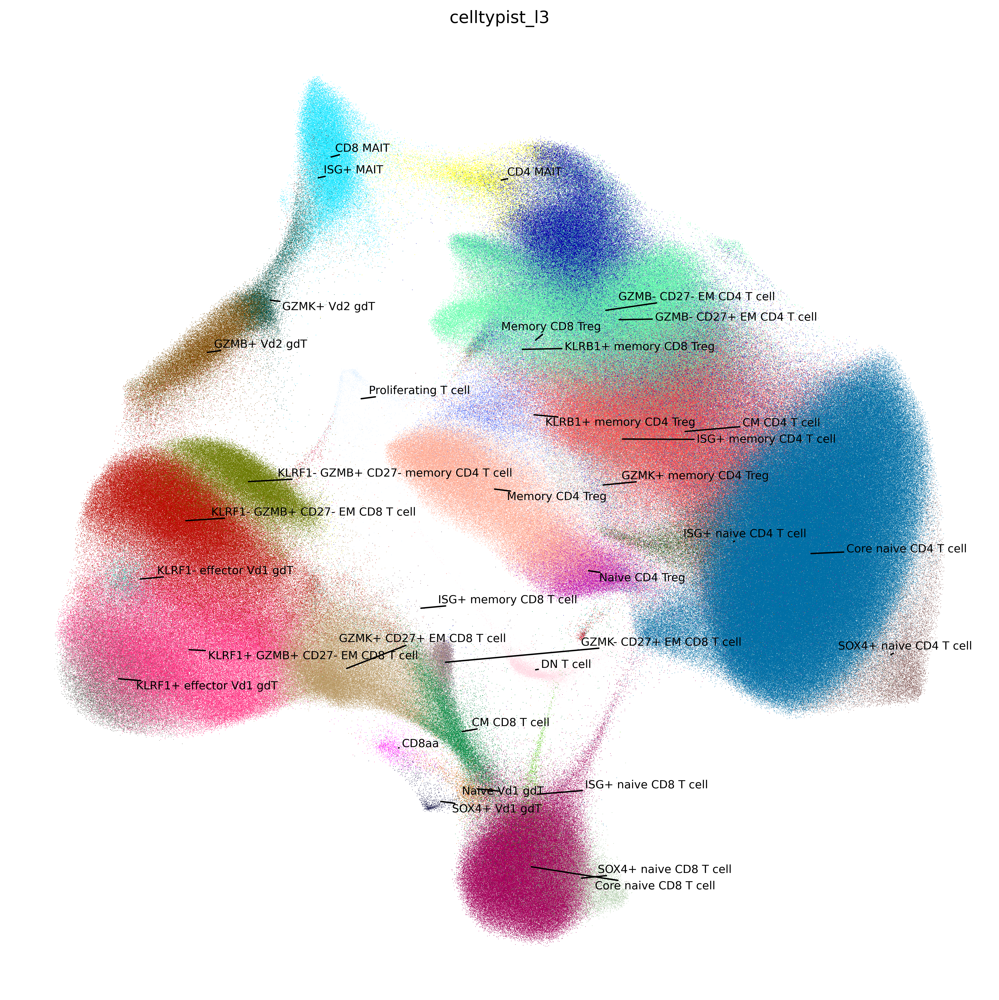

In [7]:
with plt.rc_context({"figure.figsize": (10, 10), "figure.dpi": 500, "figure.frameon": False}):
    ax=sc.pl.umap(adata, color=['celltypist_l3'], size=0.5,show=False,legend_loc=None,ncols=1 ,frameon=False)
    gen_mpl_labels(
        adata,
        "celltypist_l3",
        exclude=(""),
        ax=ax,
        adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
        text_kwargs=dict(fontsize=8),)
    fig = ax.get_figure()
    fig.tight_layout()


In [ ]:
adata

In [ ]:
adata=adata.raw.to_adata()
adata.write_h5ad('Tcells_leiden.h5ad')